In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/deepfake-detection-challenge/sample_submission.csv
/kaggle/input/deepfake-detection-challenge/test_videos/qooxnxqqjb.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/hierggamuo.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/ocgdbrgmtq.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/icbsahlivv.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/prhmixykhr.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/ihglzxzroo.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/yarpxfqejd.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/orixbcfvdz.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/qxyrtwozyw.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/hqzwudvhih.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/ghnpsltzyn.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/ziipxxchai.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/fddmkqjwsh.mp4
/kaggle/input/deepfake-de

In [2]:
import numpy as np
import pandas as pd
import os
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook
%matplotlib inline 
import cv2 as cv

In [3]:
DATA_FOLDER = '../input/deepfake-detection-challenge'
TRAIN_SAMPLE_FOLDER = 'train_sample_videos'
TEST_FOLDER = 'test_videos'

print(f"Train samples: {len(os.listdir(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER)))}")
print(f"Test samples: {len(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER)))}")

Train samples: 401
Test samples: 400


In [4]:
FACE_DETECTION_FOLDER = '/kaggle/input/deepfake-detection-challenge'
print(f"Face detection resources: {os.listdir(FACE_DETECTION_FOLDER)}")

Face detection resources: ['test_videos', 'sample_submission.csv', 'train_sample_videos']


In [5]:
train_list = list(os.listdir(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER)))
ext_dict = []
for file in train_list:
    file_ext = file.split('.')[1]
    if (file_ext not in ext_dict):
        ext_dict.append(file_ext)
print(f"Extensions: {ext_dict}") 

Extensions: ['mp4', 'json']


In [6]:
for file_ext in ext_dict:
    print(f"Files with extension `{file_ext}`: {len([file for file in train_list if  file.endswith(file_ext)])}")

Files with extension `mp4`: 400
Files with extension `json`: 1


In [7]:
test_list = list(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER)))
ext_dict = []
for file in test_list:
    file_ext = file.split('.')[1]
    if (file_ext not in ext_dict):
        ext_dict.append(file_ext)
print(f"Extensions: {ext_dict}")
for file_ext in ext_dict:
    print(f"Files with extension `{file_ext}`: {len([file for file in train_list if  file.endswith(file_ext)])}")

Extensions: ['mp4']
Files with extension `mp4`: 400


In [8]:
json_file = [file for file in train_list if  file.endswith('json')][0]
print(f"JSON file: {json_file}")

JSON file: metadata.json


In [9]:
def get_meta_from_json(path):
    df = pd.read_json(os.path.join(DATA_FOLDER, path, json_file))
    df = df.T
    return df

meta_train_df = get_meta_from_json(TRAIN_SAMPLE_FOLDER)
meta_train_df.head()

,label,split,original
aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,train,None
abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


In [10]:
def missing_data(data):
    total = data.isnull().sum()
    percent = (data.isnull().sum()/data.isnull().count()*100)
    tt = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
    types = []
    for col in data.columns:
        dtype = str(data[col].dtype)
        types.append(dtype)
    tt['Types'] = types
    return(np.transpose(tt))


In [11]:
missing_data(meta_train_df)

,label,split,original
Total,0,0,77
Percent,0.0,0.0,19.25
Types,object,object,object


In [12]:
missing_data(meta_train_df.loc[meta_train_df.label=='REAL'])

,label,split,original
Total,0,0,77
Percent,0.0,0.0,100.0
Types,object,object,object


In [13]:
def missing_data(data):
    total = data.isnull().sum()
    percent = (data.isnull().sum()/data.isnull().count()*100)
    tt = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
    types = []
    for col in data.columns:
        dtype = str(data[col].dtype)
        types.append(dtype)
    tt['Types'] = types
    return(np.transpose(tt))

In [14]:
missing_data(meta_train_df)

,label,split,original
Total,0,0,77
Percent,0.0,0.0,19.25
Types,object,object,object


In [15]:
missing_data(meta_train_df.loc[meta_train_df.label=='REAL'])

,label,split,original
Total,0,0,77
Percent,0.0,0.0,100.0
Types,object,object,object


In [16]:
def unique_values(data):
    total = data.count()
    tt = pd.DataFrame(total)
    tt.columns = ['Total']
    uniques = []
    for col in data.columns:
        unique = data[col].nunique()
        uniques.append(unique)
    tt['Uniques'] = uniques
    return(np.transpose(tt))

In [17]:
unique_values(meta_train_df)

,label,split,original
Total,400,400,323
Uniques,2,1,209


In [18]:
def most_frequent_values(data):
    total = data.count()
    tt = pd.DataFrame(total)
    tt.columns = ['Total']
    items = []
    vals = []
    for col in data.columns:
        itm = data[col].value_counts().index[0]
        val = data[col].value_counts().values[0]
        items.append(itm)
        vals.append(val)
    tt['Most frequent item'] = items
    tt['Frequence'] = vals
    tt['Percent from total'] = np.round(vals / total * 100, 3)
    return(np.transpose(tt))

In [19]:
most_frequent_values(meta_train_df)

,label,split,original
Total,400,400,323
Most frequent item,FAKE,train,atvmxvwyns.mp4
Frequence,323,400,6
Percent from total,80.75,100.0,1.858


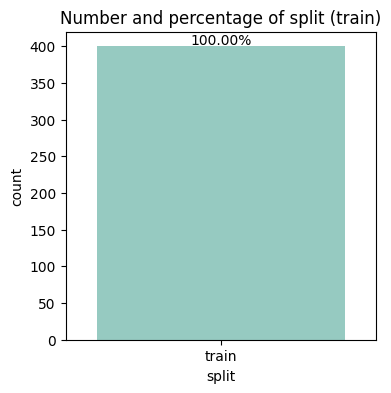

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_count(feature, title, df, size=1):
    '''
    Plot count of classes / feature
    param: feature - the feature to analyze
    param: title - title to add to the graph
    param: df - dataframe from which we plot feature's classes distribution 
    param: size - default 1.
    '''
    # Create a subplot with the specified size
    f, ax = plt.subplots(1, 1, figsize=(4*size, 4))
    
    # Total number of entries in the dataframe
    total = float(len(df))
    
    # Create the count plot on the specified axis
    g = sns.countplot(x=df[feature], order=df[feature].value_counts().index[:20], palette='Set3', ax=ax)
    g.set_title("Number and percentage of {}".format(title))
    
    # Rotate x-axis labels if size is larger than 2, or if the labels are too long
    if size > 2 or len(df[feature].unique()) > 10:
        plt.xticks(rotation=90, size=8)
    
    # Annotate the bars with the percentage
    for p in ax.patches:
        height = p.get_height()
        ax.text(p.get_x() + p.get_width() / 2.,
                height + 3,
                '{:1.2f}%'.format(100 * height / total),
                ha="center")
    
    # Show the plot
    plt.show()

# Example usage:
plot_count('split', 'split (train)', meta_train_df)


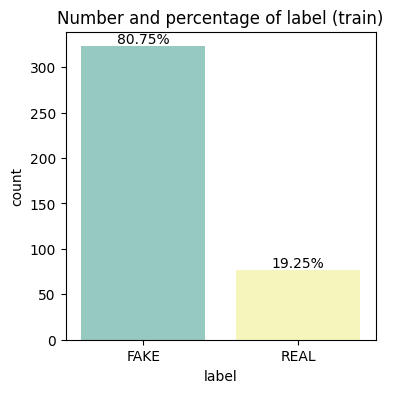

In [21]:
plot_count('label', 'label (train)', meta_train_df)

In [22]:
meta = np.array(list(meta_train_df.index))
storage = np.array([file for file in train_list if  file.endswith('mp4')])
print(f"Metadata: {meta.shape[0]}, Folder: {storage.shape[0]}")
print(f"Files in metadata and not in folder: {np.setdiff1d(meta,storage,assume_unique=False).shape[0]}")
print(f"Files in folder and not in metadata: {np.setdiff1d(storage,meta,assume_unique=False).shape[0]}")

Metadata: 400, Folder: 400
Files in metadata and not in folder: 0
Files in folder and not in metadata: 0


In [23]:
fake_train_sample_video = list(meta_train_df.loc[meta_train_df.label=='FAKE'].sample(3).index)
fake_train_sample_video

['diomeixhrg.mp4', 'dvakowbgbt.mp4', 'akvmwkdyuv.mp4']

In [24]:
def display_image_from_video(video_path):
    '''
    input: video_path - path for video
    process:
    1. perform a video capture from the video
    2. read the image
    3. display the image
    '''
    capture_image = cv.VideoCapture(video_path) 
    ret, frame = capture_image.read()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
    ax.imshow(frame)

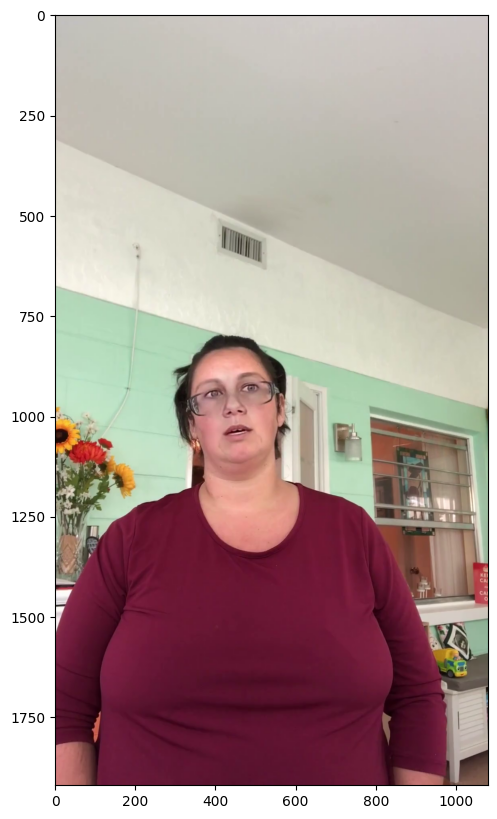

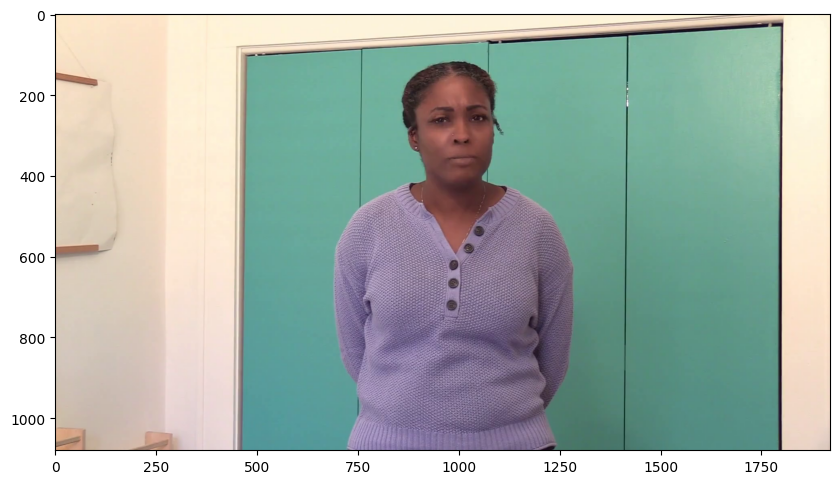

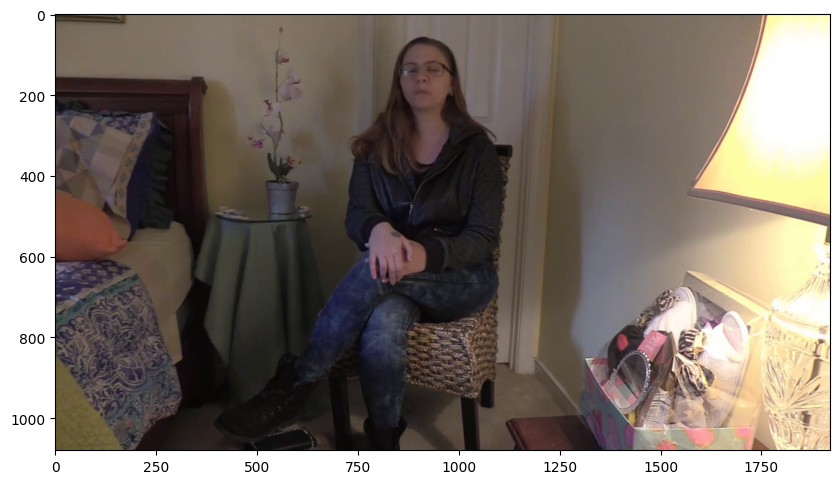

In [25]:
for video_file in fake_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

In [26]:
real_train_sample_video = list(meta_train_df.loc[meta_train_df.label=='REAL'].sample(3).index)
real_train_sample_video

['dbtbbhakdv.mp4', 'ckjaibzfxa.mp4', 'chviwxsfhg.mp4']

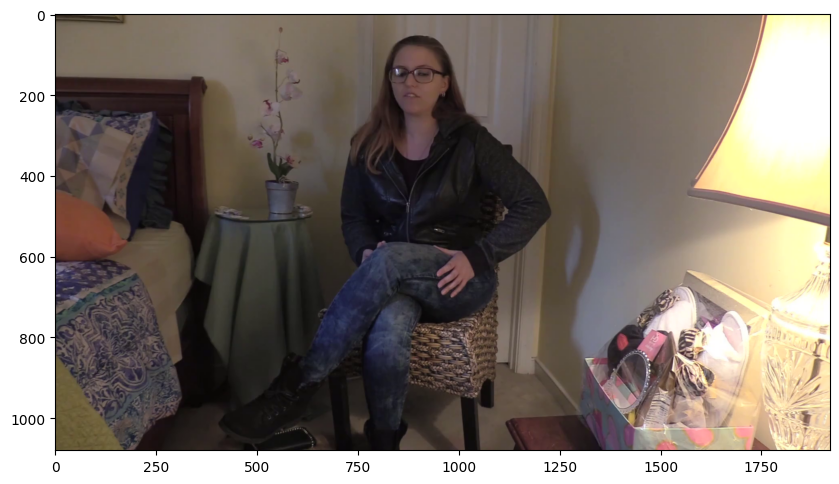

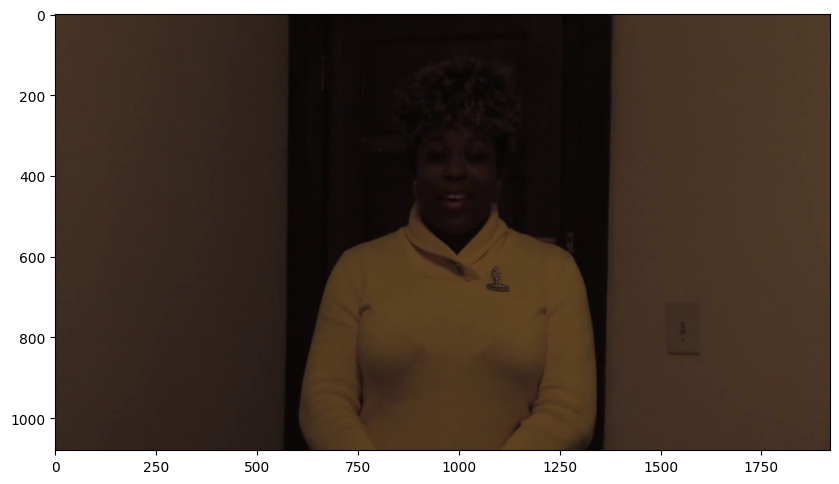

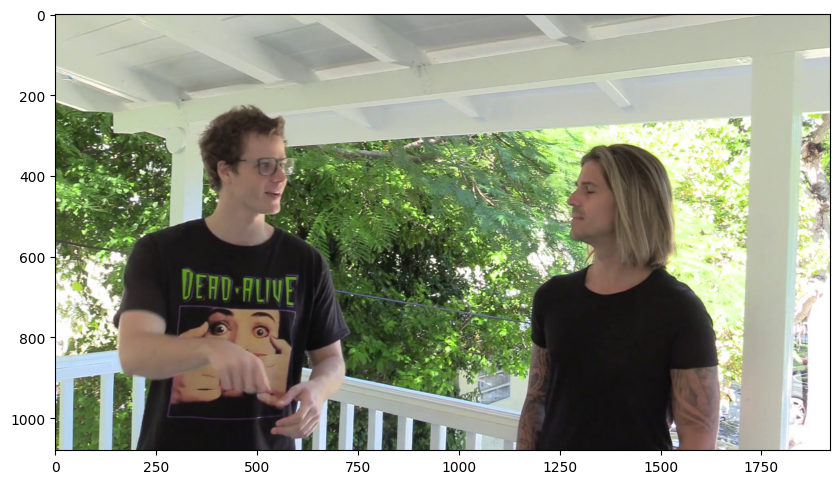

In [27]:
for video_file in real_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

In [28]:
meta_train_df['original'].value_counts()[0:5]

original
atvmxvwyns.mp4    6
meawmsgiti.mp4    6
qeumxirsme.mp4    5
kgbkktcjxf.mp4    5
dzyuwjkjui.mp4    4
Name: count, dtype: int64

In [29]:
def display_image_from_video_list(video_path_list, video_folder=TRAIN_SAMPLE_FOLDER):
    '''
    input: video_path_list - path for video
    process:
    0. for each video in the video path list
        1. perform a video capture from the video
        2. read the image
        3. display the image
    '''
    plt.figure()
    fig, ax = plt.subplots(2,3,figsize=(16,8))
    # we only show images extracted from the first 6 videos
    for i, video_file in enumerate(video_path_list[0:6]):
        video_path = os.path.join(DATA_FOLDER, video_folder,video_file)
        capture_image = cv.VideoCapture(video_path) 
        ret, frame = capture_image.read()
        frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
        ax[i//3, i%3].imshow(frame)
        ax[i//3, i%3].set_title(f"Video: {video_file}")
        ax[i//3, i%3].axis('on')

<Figure size 640x480 with 0 Axes>

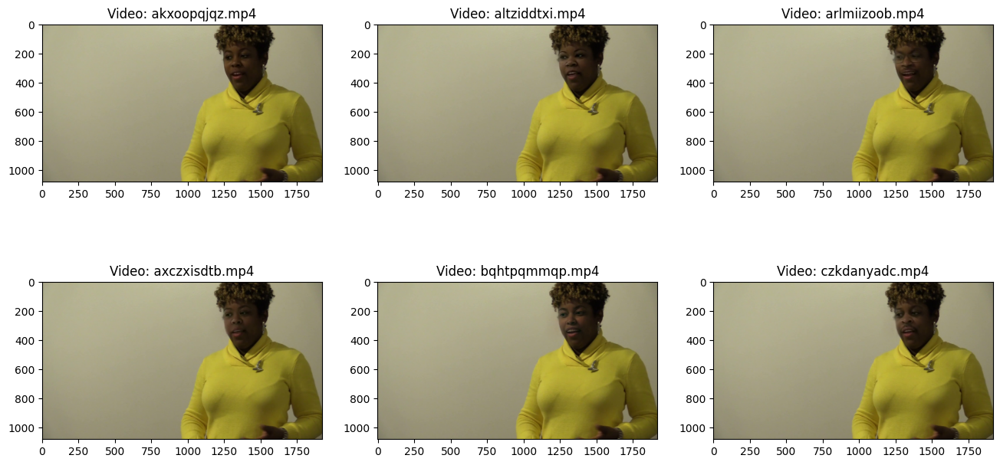

In [30]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='meawmsgiti.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

<Figure size 640x480 with 0 Axes>

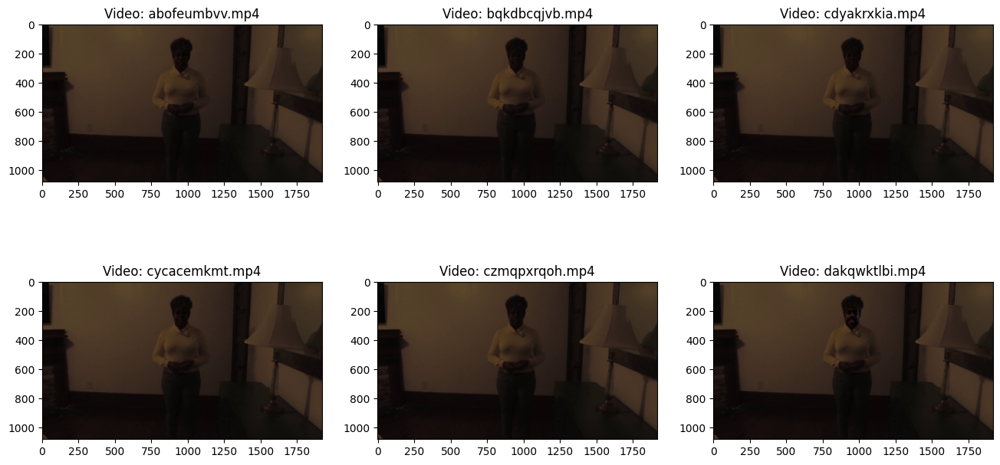

In [31]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='atvmxvwyns.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

<Figure size 640x480 with 0 Axes>

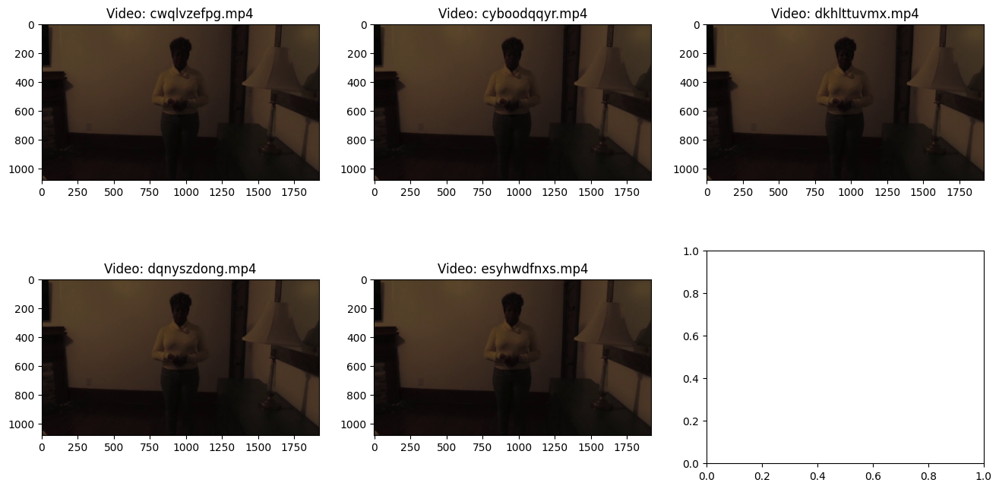

In [32]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='qeumxirsme.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

In [33]:
test_videos = pd.DataFrame(list(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER))), columns=['video'])

In [34]:
test_videos.head()

,video
0,qooxnxqqjb.mp4
1,hierggamuo.mp4
2,ocgdbrgmtq.mp4
3,icbsahlivv.mp4
4,prhmixykhr.mp4


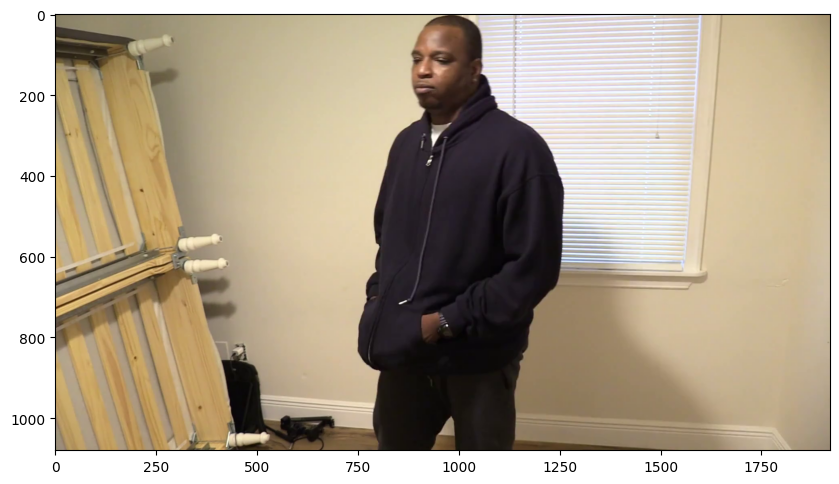

In [35]:
display_image_from_video(os.path.join(DATA_FOLDER, TEST_FOLDER, test_videos.iloc[0].video))


<Figure size 640x480 with 0 Axes>

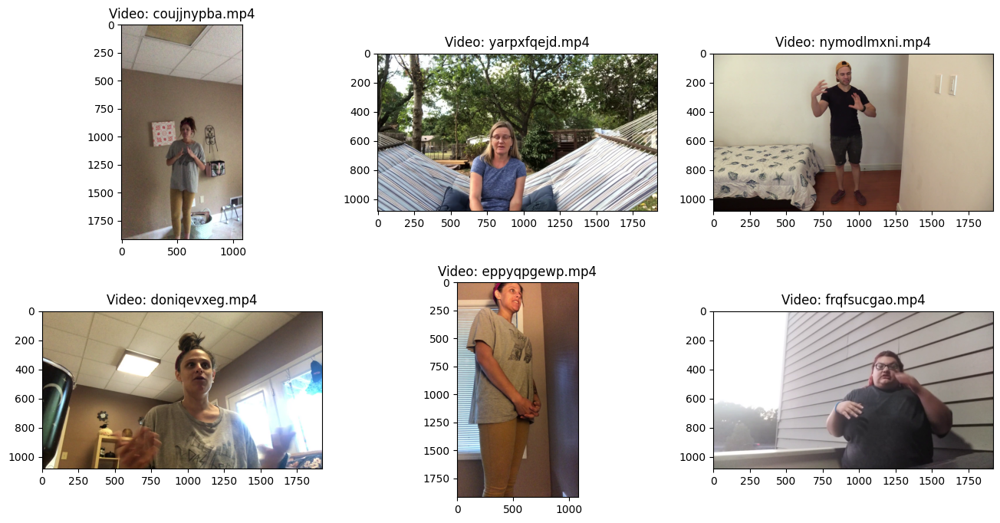

In [36]:
display_image_from_video_list(test_videos.sample(6).video, TEST_FOLDER)

In [37]:
# Create a directory to store the Haar cascade files
import os

FACE_DETECTION_FOLDER = './haarcascades/'
os.makedirs(FACE_DETECTION_FOLDER, exist_ok=True)

# Download the necessary Haar cascades using wget
!wget -P {FACE_DETECTION_FOLDER} https://github.com/opencv/opencv/raw/master/data/haarcascades/haarcascade_frontalface_default.xml
!wget -P {FACE_DETECTION_FOLDER} https://github.com/opencv/opencv/raw/master/data/haarcascades/haarcascade_eye.xml
!wget -P {FACE_DETECTION_FOLDER} https://github.com/opencv/opencv/raw/master/data/haarcascades/haarcascade_smile.xml
!wget -P {FACE_DETECTION_FOLDER} https://github.com/opencv/opencv/raw/master/data/haarcascades/haarcascade_profileface.xml

# Verify that the files have been downloaded
os.listdir(FACE_DETECTION_FOLDER)


--2024-09-06 16:46:41--  https://github.com/opencv/opencv/raw/master/data/haarcascades/haarcascade_frontalface_default.xml
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml [following]
--2024-09-06 16:46:41--  https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 930127 (908K) [text/plain]
Saving to: './haarcascades/haarcascade_frontalface_default.xml.3'

haarcascade_frontal 100%[===================>] 908.33K  --.-KB/s    

['haarcascade_smile.xml.2',
 'haarcascade_profileface.xml',
 'haarcascade_frontalface_default.xml',
 'haarcascade_eye.xml.3',
 'haarcascade_smile.xml.3',
 'haarcascade_profileface.xml.1',
 'haarcascade_eye.xml.1',
 'haarcascade_frontalface_default.xml.3',
 'haarcascade_profileface.xml.2',
 'haarcascade_eye.xml',
 'haarcascade_profileface.xml.3',
 'haarcascade_eye.xml.2',
 'haarcascade_frontalface_default.xml.1',
 'haarcascade_frontalface_default.xml.2',
 'haarcascade_smile.xml',
 'haarcascade_smile.xml.1']

In [38]:
import cv2 as cv

class ObjectDetector:
    '''
    Class for Object Detection using Haar cascades.
    '''

    def __init__(self, object_cascade_path):
        '''
        param: object_cascade_path - path for the *.xml file defining the Haar cascade for object detection
        This can be used for face, eye, smile, profile detection.
        '''
        # Check if the file exists before loading
        if not os.path.exists(object_cascade_path):
            raise FileNotFoundError(f"File not found: {object_cascade_path}")
        
        # Load the cascade classifier
        self.objectCascade = cv.CascadeClassifier(object_cascade_path)

        # Check if the classifier loaded correctly
        if self.objectCascade.empty():
            raise ValueError(f"Error loading cascade classifier from {object_cascade_path}")

    def detect(self, image, scale_factor=1.3, min_neighbors=5, min_size=(20, 20)):
        '''
        Function returns rectangle coordinates of detected objects in a given image.
        param: image - image to process (should be a grayscale image)
        param: scale_factor - scale factor used for object detection
        param: min_neighbors - minimum number of neighbors required to retain a detection
        param: min_size - minimum size of bounding box for detected objects
        '''
        # Convert to grayscale if the image is not already
        if len(image.shape) == 3:  # If the image has 3 channels (color image)
            gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
        else:
            gray = image

        # Detect objects in the image
        rects = self.objectCascade.detectMultiScale(
            gray,
            scaleFactor=scale_factor,
            minNeighbors=min_neighbors,
            minSize=min_size
        )
        return rects

# Paths for various Haar cascades
frontal_cascade_path = os.path.join(FACE_DETECTION_FOLDER, '/kaggle/input/haarcascades/data/haarcascades/haarcascade_frontalface_default.xml')
eye_cascade_path = os.path.join(FACE_DETECTION_FOLDER, '/kaggle/input/haarcascades/data/haarcascades/haarcascade_eye.xml')
profile_cascade_path = os.path.join(FACE_DETECTION_FOLDER, '/kaggle/input/haarcascades/data/haarcascades/haarcascade_profileface.xml')
smile_cascade_path = os.path.join(FACE_DETECTION_FOLDER, '/kaggle/input/haarcascades/data/haarcascades/haarcascade_smile.xml')

# Create detector objects for different features
fd = ObjectDetector(frontal_cascade_path)  # Frontal face detector
ed = ObjectDetector(eye_cascade_path)      # Eye detector
pd = ObjectDetector(profile_cascade_path)  # Profile face detector
sd = ObjectDetector(smile_cascade_path)    # Smile detector

# Now you can use these detectors on images loaded in your Kaggle notebook.


In [39]:
def detect_objects(image, scale_factor, min_neighbors, min_size):
    '''
    Objects detection function
    Identify frontal face, eyes, smile and profile face and display the detected objects over the image
    param: image - the image extracted from the video
    param: scale_factor - scale factor parameter for `detect` function of ObjectDetector object
    param: min_neighbors - min neighbors parameter for `detect` function of ObjectDetector object
    param: min_size - minimum size parameter for f`detect` function of ObjectDetector object
    '''
    
    image_gray=cv.cvtColor(image, cv.COLOR_BGR2GRAY)


    eyes=ed.detect(image_gray,
                   scale_factor=scale_factor,
                   min_neighbors=min_neighbors,
                   min_size=(int(min_size[0]/2), int(min_size[1]/2)))

    for x, y, w, h in eyes:
        #detected eyes shown in color image
        cv.circle(image,(int(x+w/2),int(y+h/2)),(int((w + h)/4)),(0, 0,255),3)
 
    # deactivated due to many false positive
    #smiles=sd.detect(image_gray,
    #               scale_factor=scale_factor,
    #               min_neighbors=min_neighbors,
    #               min_size=(int(min_size[0]/2), int(min_size[1]/2)))

    #for x, y, w, h in smiles:
    #    #detected smiles shown in color image
    #    cv.rectangle(image,(x,y),(x+w, y+h),(0, 0,255),3)


    profiles=pd.detect(image_gray,
                   scale_factor=scale_factor,
                   min_neighbors=min_neighbors,
                   min_size=min_size)

    for x, y, w, h in profiles:
        #detected profiles shown in color image
        cv.rectangle(image,(x,y),(x+w, y+h),(255, 0,0),3)

    faces=fd.detect(image_gray,
                   scale_factor=scale_factor,
                   min_neighbors=min_neighbors,
                   min_size=min_size)

    for x, y, w, h in faces:
        #detected faces shown in color image
        cv.rectangle(image,(x,y),(x+w, y+h),(0, 255,0),3)

    # image
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    ax.imshow(image)

In [40]:
def extract_image_objects(video_file, video_set_folder=TRAIN_SAMPLE_FOLDER):
    '''
    Extract one image from the video and then perform face/eyes/smile/profile detection on the image
    param: video_file - the video from which to extract the image from which we extract the face
    '''
    video_path = os.path.join(DATA_FOLDER, video_set_folder,video_file)
    capture_image = cv.VideoCapture(video_path) 
    ret, frame = capture_image.read()
    #frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
    detect_objects(image=frame, 
            scale_factor=1.3, 
            min_neighbors=5, 
            min_size=(50, 50))

byqzyxifza.mp4
cwrtyzndpx.mp4
cwwandrkus.mp4


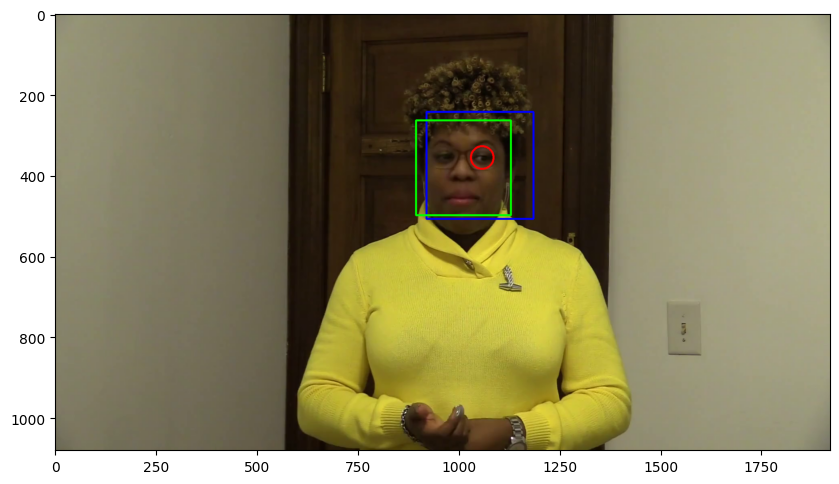

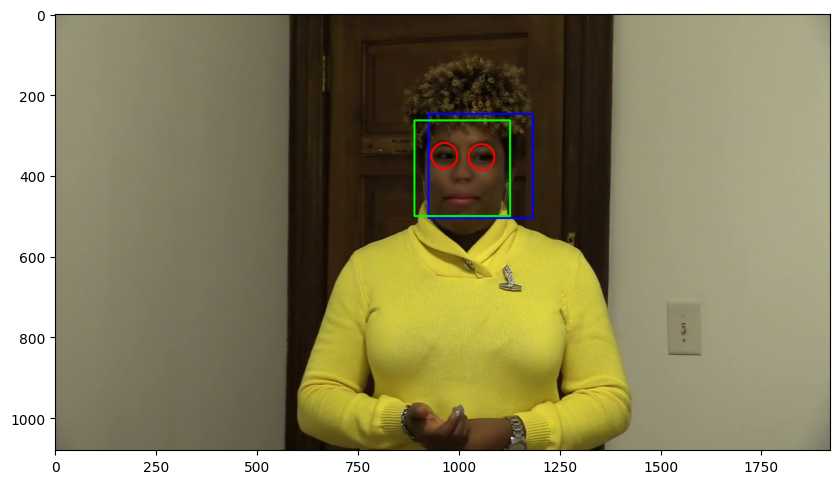

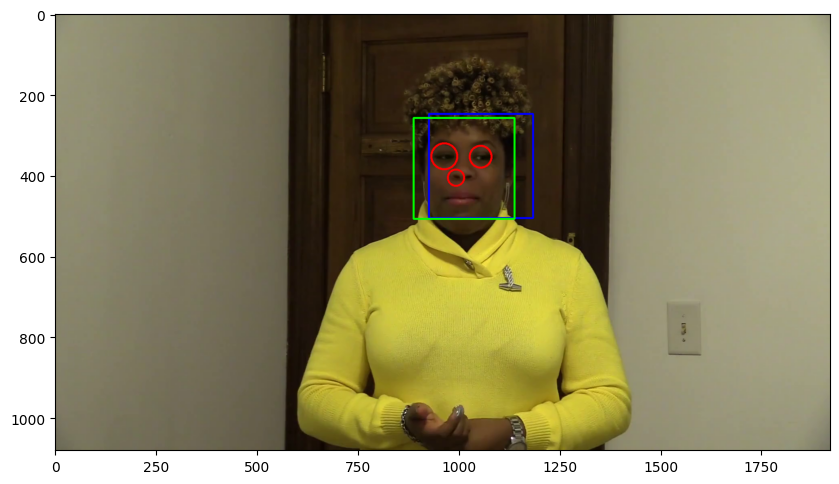

In [41]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='kgbkktcjxf.mp4'].index)
for video_file in same_original_fake_train_sample_video[1:4]:
    print(video_file)
    extract_image_objects(video_file)

diomeixhrg.mp4
byqzyxifza.mp4
czkdanyadc.mp4


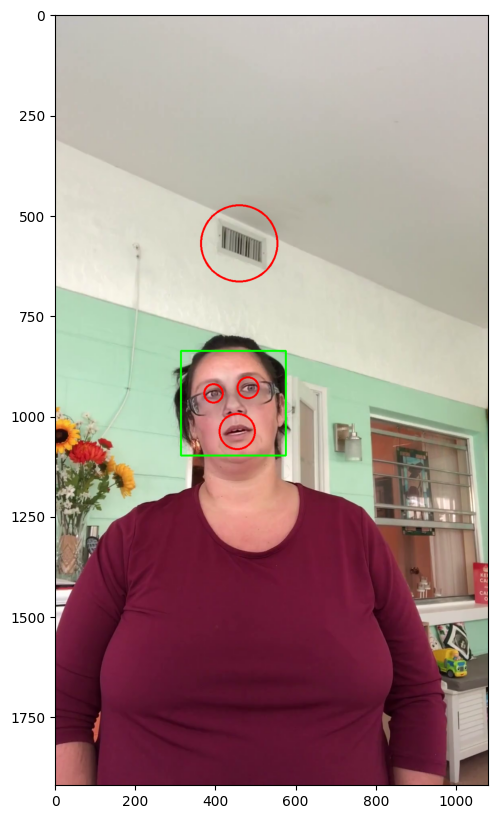

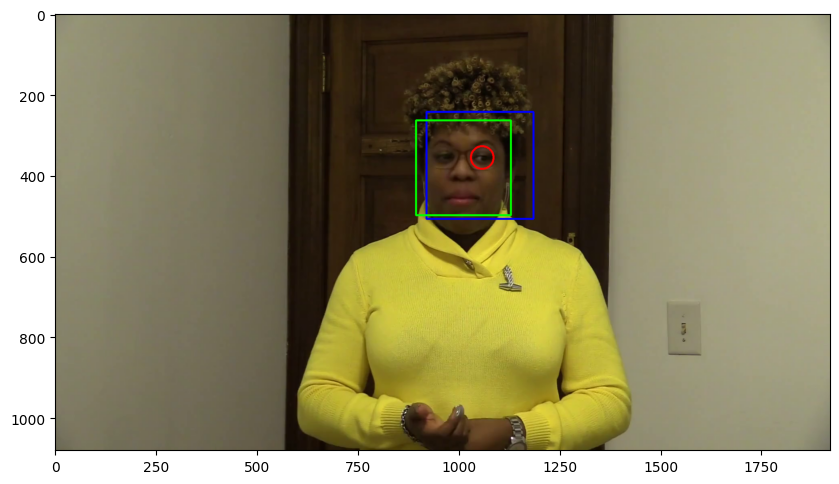

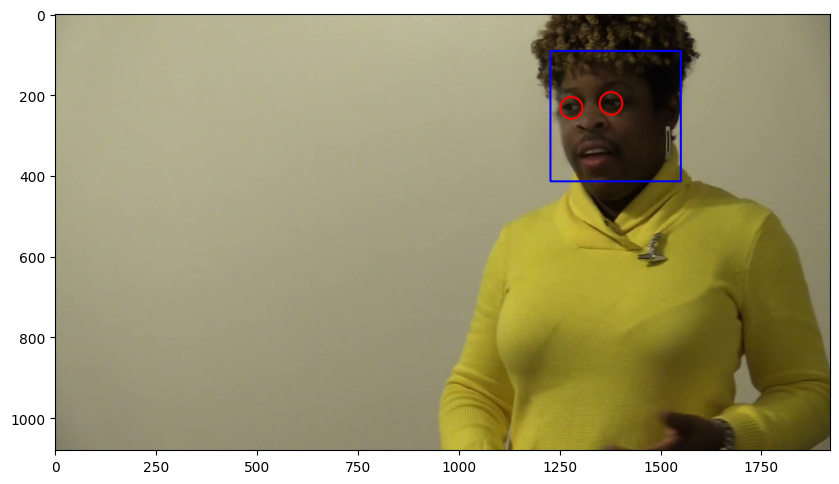

In [42]:
train_subsample_video = list(meta_train_df.sample(3).index)
for video_file in train_subsample_video:
    print(video_file)
    extract_image_objects(video_file)

In [43]:
fake_videos = list(meta_train_df.loc[meta_train_df.label=='FAKE'].index)

In [44]:
from IPython.display import HTML
from base64 import b64encode

def play_video(video_file, subset=TRAIN_SAMPLE_FOLDER):
    '''
    Display video
    param: video_file - the name of the video file to display
    param: subset - the folder where the video file is located (can be TRAIN_SAMPLE_FOLDER or TEST_Folder)
    '''
    video_url = open(os.path.join(DATA_FOLDER, subset,video_file),'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(video_url).decode()
    return HTML("""<video width=500 controls><source src="%s" type="video/mp4"></video>""" % data_url)

In [45]:
play_video(fake_videos[0])

In [46]:
play_video(fake_videos[2])

In [48]:
import os
import json
import pandas as pd

# Define the dataset paths
TRAIN_VIDEOS_FOLDER = '/kaggle/input/deepfake-detection-challenge/train_sample_videos'
TEST_VIDEOS_FOLDER = '/kaggle/input/deepfake-detection-challenge/test_videos'

# Load the metadata (usually a JSON file with labels)
metadata_path = os.path.join(TRAIN_VIDEOS_FOLDER, 'metadata.json')
with open(metadata_path, 'r') as f:
    metadata = json.load(f)

# Convert metadata into a pandas DataFrame
train_df = pd.DataFrame.from_dict(metadata, orient='index')
train_df.reset_index(inplace=True)

# Update the column names to match the fields in the metadata
train_df.columns = ['filename', 'label', 'split', 'original']

# Display the first few rows
train_df.head()


,filename,label,split,original
0,aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
1,aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
2,abarnvbtwb.mp4,REAL,train,None
3,abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
4,abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


In [49]:
import os
import cv2
import json

# Define the dataset paths
TRAIN_VIDEOS_FOLDER = '/kaggle/input/deepfake-detection-challenge/train_sample_videos'
FRAME_OUTPUT_FOLDER = './train_frames'

# Load the metadata (JSON file with labels)
metadata_path = os.path.join(TRAIN_VIDEOS_FOLDER, 'metadata.json')
with open(metadata_path, 'r') as f:
    metadata = json.load(f)

# Function to extract frames from a video
def extract_frames_from_video(video_path, output_folder, frame_rate=1):
    """
    Extract frames from a video file at the specified frame rate.
    :param video_path: Path to the video file
    :param output_folder: Folder to save the extracted frames
    :param frame_rate: Number of frames per second to save
    """
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    video_capture = cv2.VideoCapture(video_path)
    frame_count = 0
    success = True

    while success:
        success, image = video_capture.read()
        if success and frame_count % int(video_capture.get(cv2.CAP_PROP_FPS) // frame_rate) == 0:
            frame_filename = os.path.join(output_folder, f'frame_{frame_count}.jpg')
            cv2.imwrite(frame_filename, image)
        frame_count += 1
    video_capture.release()

# Iterate over the videos in the metadata and extract frames
for video_file, video_info in metadata.items():
    # Determine if the video is real or fake
    label = video_info['label']  # 'FAKE' or 'REAL'
    
    # Set the corresponding output directory (e.g., ./train_frames/real or ./train_frames/fake)
    output_dir = os.path.join(FRAME_OUTPUT_FOLDER, label.lower())

    # Video file path
    video_path = os.path.join(TRAIN_VIDEOS_FOLDER, video_file)

    # Extract frames from the video
    extract_frames_from_video(video_path, output_dir, frame_rate=1)

print("Frame extraction complete.")



Frame extraction complete.


In [50]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.optimizers import Adam

# Set up ImageDataGenerator for training and validation
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_generator = train_datagen.flow_from_directory(
    './train_frames',  # Folder containing frames (should have 'real' and 'fake' subfolders)
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    './train_frames',
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    subset='validation'
)

# Build a simple CNN model
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    MaxPooling2D(pool_size=(2, 2)),
    
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid')  # Binary classification (fake or real)
])

# Compile the model with the correct learning rate argument
model.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=10
)


Found 18 images belonging to 2 classes.
Found 4 images belonging to 2 classes.


/opt/conda/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1725642009.754958   15071 service.cc:145] XLA service 0x7c0f50a9f370 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1725642009.755033   15071 service.cc:153]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1725642009.755042   15071 service.cc:153]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - accuracy: 0.5000 - loss: 0.6867

I0000 00:00:1725642014.946210   15071 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step - accuracy: 0.5000 - loss: 0.6867 - val_accuracy: 0.5000 - val_loss: 0.5193
Epoch 2/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step - accuracy: 0.5000 - loss: 0.5311 - val_accuracy: 0.5000 - val_loss: 0.4866
Epoch 3/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step - accuracy: 0.5000 - loss: 0.4878 - val_accuracy: 0.5000 - val_loss: 0.4679
Epoch 4/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step - accuracy: 0.5000 - loss: 0.4742 - val_accuracy: 0.5000 - val_loss: 0.4358
Epoch 5/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step - accuracy: 0.5000 - loss: 0.4280 - val_accuracy: 0.5000 - val_loss: 0.3956
Epoch 6/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step - accuracy: 0.5000 - loss: 0.4007 - val_accuracy: 1.0000 - val_loss: 0.3616
Epoch 7/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step - accuracy: 0.7778 - loss: 0.3608 - val_accuracy: 1.0000 - val_loss: 0.3338
Epoch 8/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step - accuracy: 0.9444 - loss: 0.3358 - val_accuracy: 1.0000 - val_loss: 0.3127
Epoch 

In [51]:
import cv2
import numpy as np
from tensorflow.keras.preprocessing.image import img_to_array, load_img
import os

# Directory where test videos are stored
TEST_VIDEOS_FOLDER = '/kaggle/input/deepfake-detection-challenge/test_videos'

# Function to extract frames from a video
def extract_frames(video_path, max_frames=10):
    frames = []
    cap = cv2.VideoCapture(video_path)
    
    frame_count = 0
    while cap.isOpened() and frame_count < max_frames:
        ret, frame = cap.read()
        if not ret:
            break
        frame = cv2.resize(frame, (224, 224))
        frame = img_to_array(frame)
        frame = frame / 255.0  # Rescale to [0,1]
        frames.append(frame)
        frame_count += 1

    cap.release()
    return np.array(frames)

# Get list of all test video files
test_videos = os.listdir(TEST_VIDEOS_FOLDER)

# Create a dictionary to store predictions
predictions = {}

# Loop over test videos and make predictions
for video_file in test_videos:
    video_path = os.path.join(TEST_VIDEOS_FOLDER, video_file)
    
    # Extract frames
    frames = extract_frames(video_path)
    
    # If frames were extracted
    if len(frames) > 0:
        # Predict on each frame
        preds = model.predict(frames)
        
        # Average the predictions from all frames
        avg_pred = np.mean(preds)
        
        # Store the result in the dictionary
        predictions[video_file] = 'FAKE' if avg_pred > 0.5 else 'REAL'

# Print the predictions for all test videos
count = 0
for video, label in predictions.items():
    print(f"Video: {video}, Prediction: {label}")
    count+=1


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 842ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━

In [52]:

# Save the model
model.save('/kaggle/working/trained_model.h5')
print("Model saved successfully!")

Model saved successfully!


In [53]:
from tensorflow.keras.models import load_model

# Load the model
model = load_model('/kaggle/working/trained_model.h5')
print("Model loaded successfully!")


Model loaded successfully!


In [54]:
def predict_video(video_file):
    video_path = os.path.join(TEST_VIDEOS_FOLDER, video_file)
    
    if not os.path.exists(video_path):
        raise FileNotFoundError(f"Video file '{video_file}' not found in '{TEST_VIDEOS_FOLDER}'")
    
    # Extract frames
    frames = extract_frames(video_path)
    
    # If frames were extracted
    if len(frames) > 0:
        # Predict on each frame
        preds = model.predict(frames)
        
        # Average the predictions from all frames
        avg_pred = np.mean(preds)
        
        # Determine the final result
        return 'FAKE' if avg_pred > 0.5 else 'REAL'
    else:
        raise ValueError("No frames were extracted from the video.")

# Example usage
if __name__ == "__main__":
    # Enter the filename of the video to predict
    video_file = input("Enter the filename of the video (e.g., 'video_1.mp4'): ")
    
    try:
        result = predict_video(video_file)
        print(f"The video '{video_file}' is predicted to be: {result}")
    except Exception as e:
        print(f"Error: {e}")

Enter the filename of the video (e.g., 'video_1.mp4'):  iksxzpqxzi.mp4


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
The video 'iksxzpqxzi.mp4' is predicted to be: REAL
